### Preprocess 2D Maps and save to a FITS file

In [2]:
import numpy as np
from astropy.io import fits
import matplotlib.pyplot as plt
plt.style.use('seaborn-dark')
from matplotlib import colors
import astropy.units as u
import glob
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from marvin.tools.image import Image
import matplotlib.image as mpimg

INFO: No release version set. Setting default to DR15
[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/sdsstools/configuration.py:223: ResourceWarning:

unclosed file <_io.TextIOWrapper name='/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/marvin/extern/tree/python/tree/etc/tree.yml' mode='r' encoding='US-ASCII'>


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/sdsstools/configuration.py:223: ResourceWarning:

unclosed file <_io.TextIOWrapper name='/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/marvin/extern/sdss_access/python/sdss_access/etc/sdss_access.yml' mode='r' encoding='US-ASCII'>


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/marvin/__init__.py:401: MarvinUserWarning:

path /Users/mmckay/sas/dr15/manga/spectro/analysis/v2_4_3/2.2.1/dapall-v2_4_3-2.2.1.fits cannot be found. Setting dapall to None.


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/importlib

# 2D map pre-processing
### 1. Read in FITS files
### 2. Convert all +/- np.inf values to np.nan
### 3. Examine maps using interactive plots
### 4. Apply emission line SNR cuts

In [47]:
# Preprocessing function
def apply_2Difu_snr_cut(hdu, ifu_2dmap):
    """
    About:
        This function will make signal-to-noise cuts to a specified data extension in 
        the FITS files produced by Myles McKay
    
    Parameters:
        hdu: fits files 
        
        ifu_2dmap: (ndarray)
            2 dimensional array that reperesnet the MaNGA IFU map


    """
    ifu_2d_ppd_map = ifu_2dmap
    ifu_2d_ppd_map[hdu['HALPHA SNR'].data < 5] = np.nan # Halpha mask with all the Halpha SNR spaxels < 3 set to np.nan
    ifu_2d_ppd_map[hdu['HBETA SNR'].data < 3] = np.nan 
    ifu_2d_ppd_map[hdu['NII6585 SNR'].data < 2] = np.nan 
    ifu_2d_ppd_map[hdu['OII3727 SNR'].data < 2] = np.nan 
    ifu_2d_ppd_map[hdu['OII3729 SNR'].data < 2] = np.nan 

    return ifu_2d_ppd_map

In [48]:
# Q18 fit fundtion
def q18_diagnostic_polyfit(Q18_n2o2_range = np.linspace(-1.5,0.6,50)):
    Q18_o3ha_range_medfit = -1.09 - (0.11 * Q18_n2o2_range) + (1.39 * Q18_n2o2_range**2) + (0.67 * Q18_n2o2_range**3)
    Q18_o3ha_range_1sigma = -1.22 - (0.09 * Q18_n2o2_range) + (1.48 * Q18_n2o2_range**2) + (0.76 * Q18_n2o2_range**3) # 16th    percentile of fit but rerpersents 1 sigma
    Q18_o3ha_range_3sigma = -1.47 - (0.21 * Q18_n2o2_range) + (1.04 * Q18_n2o2_range**2) + (0.53 * Q18_n2o2_range**3) # .15th   percentile of fit but rerpersents 3 sigma
        
    return Q18_o3ha_range_medfit, Q18_o3ha_range_1sigma, Q18_o3ha_range_3sigma

In [59]:
# Full function to preprocess and make Q18 diagnostic plots using FITS files I made prior
def Q18_2d_diagnostic(hdu, plateifu, sample):
    """
    
    """
    


    # Applying Preprocessing to emission flux maps
    ha_kcorr_ppd_map = apply_2Difu_snr_cut(hdu, hdu['HALPHA KCORR'].data)
    o3_kcorr_ppd_map = apply_2Difu_snr_cut(hdu, hdu['OIII5008 KCORR'].data)
    n2_kcorr_ppd_map = apply_2Difu_snr_cut(hdu, hdu['NII6585 KCORR'].data)
    o2_3727_kcorr_ppd_map = apply_2Difu_snr_cut(hdu, hdu['OII3727 KCORR'].data)
    o2_3729_kcorr_ppd_map = apply_2Difu_snr_cut(hdu, hdu['OII3729 KCORR'].data)
    
    
    # Applying Preprocessing (ppd) to emission flux S/N maps
    #ha_SNR_ppd_map = apply_2Difu_snr_cut(hdu['HALPHA SNR'].data)
    o3_SNR_ppd_map = apply_2Difu_snr_cut(hdu, hdu['OIII5008 SNR'].data)
    #n2_SNR_ppd_map = apply_2Difu_snr_cut(hdu['NII6585 SNR'].data)
    #o2_3727_SNR_ppd_map = apply_2Difu_snr_cut(hdu['OII3727 SNR'].data)
    #o2_3729_SNR_ppd_map = apply_2Difu_snr_cut(hdu['OII3729 SNR'].data)
    
    ### Split OIII Map values into OIII/Halpha upper limit spaxels(OIII S/N < 2) and other 
    o3low_kcorr_ppd_map = np.copy(o3_kcorr_ppd_map)
    o3val_kcorr_ppd_map = np.copy(o3_kcorr_ppd_map)
    # (OIII/Halpha upper limit)
    o3low_kcorr_ppd_map[o3_SNR_ppd_map > 2] = np.nan # Set spaxels with S/N > 2 to nan
    o3val_kcorr_ppd_map[o3_SNR_ppd_map < 2] = np.nan # Set spaxels with S/N < 2 to nan
    
    
    
    # Calculate the Q18 diagnostic ratios
    o3ha_kcorr_tot_ppd_map = np.log10(o3_kcorr_ppd_map / ha_kcorr_ppd_map) # All spaxels 
    o3ha_uplim_kcorr_ppd_map = np.log10(o3low_kcorr_ppd_map / ha_kcorr_ppd_map) # Only OIII/Halpha upper limit
    o3ha_value_kcorr_ppd_map = np.log10(o3val_kcorr_ppd_map / ha_kcorr_ppd_map) # All spaxels below OIII/Halpha upper limit
    n2o2_kcorr_ppd_map = np.log10(n2_kcorr_ppd_map / (o2_3727_kcorr_ppd_map + o2_3729_kcorr_ppd_map))
    
    
    # remove inf and -inf values
    #N2O2
    n2o2_kcorr_ppd_map[n2o2_kcorr_ppd_map == np.inf] = np.nan
    n2o2_kcorr_ppd_map[n2o2_kcorr_ppd_map == -np.inf] = np.nan
    
    #O3Ha upper limits
    o3ha_uplim_kcorr_ppd_map[o3ha_uplim_kcorr_ppd_map == np.inf] = np.nan
    o3ha_uplim_kcorr_ppd_map[o3ha_uplim_kcorr_ppd_map == -np.inf] = np.nan
    
    #O3Ha normal values
    o3ha_value_kcorr_ppd_map[o3ha_value_kcorr_ppd_map == np.inf] = np.nan
    o3ha_value_kcorr_ppd_map[o3ha_value_kcorr_ppd_map == -np.inf] = np.nan
    
    #O3Ha full map(both upperlimit and normal values)
    o3ha_kcorr_tot_ppd_map[o3ha_kcorr_tot_ppd_map == np.inf] = np.nan
    o3ha_kcorr_tot_ppd_map[o3ha_kcorr_tot_ppd_map == -np.inf] = np.nan


    # Extract Map values into 4 sections depending on the position from Q18 median polynomial fit
    # 1. make a function to calculate median fit
    # 2. Use the function to calculate Q18 polyfit using the n2o2 relation 
    # 3. split the values into 4 individule maps by masking the maps
    # 4. Plot all the maps in combination

    # Q18 median, 1stddev, 3stddev
    # Q18_o3ha_range_medfit, Q18_o3ha_range_1sigma, Q18_o3ha_range_3sigma = q18_diagnostic_polyfit()

    # spaxels above the Q18 median fit by setting all other values to nan values 
    above_q18med = np.copy(o3ha_kcorr_tot_ppd_map)
    above_q18med[o3ha_kcorr_tot_ppd_map <= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[0]] = np.nan 

    # spaxels between median fit and 1 stddev fit
    q18std1_q18med = np.copy(o3ha_kcorr_tot_ppd_map)
    q18std1_q18med[o3ha_kcorr_tot_ppd_map <= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[1]] = np.nan
    q18std1_q18med[o3ha_kcorr_tot_ppd_map >= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[0]] = np.nan

    # spaxels between 1 stddev fit and 3 stddev fit
    q18std1_q18std3 = np.copy(o3ha_kcorr_tot_ppd_map)
    q18std1_q18std3[o3ha_kcorr_tot_ppd_map <= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[2]] = np.nan
    q18std1_q18std3[o3ha_kcorr_tot_ppd_map >= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[1]] = np.nan

    # spaxels below the 3 stddev fit 
    below_q18std3 = np.copy(o3ha_kcorr_tot_ppd_map)
    below_q18std3[o3ha_kcorr_tot_ppd_map >= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[2]] = np.nan

    # Set values to constants depending on the location on the q18 fit -- for 2d maps
    above_q18med_constmap =  np.copy(above_q18med)
    above_q18med_constmap[above_q18med > -777] = 1 # spaxels avove median

    q18std1_q18med_constmap =  np.copy(q18std1_q18med)
    q18std1_q18med_constmap[q18std1_q18med > -777] = 2 # spaxels between median and 1stddev

    q18std1_q18std3_constmap =  np.copy(q18std1_q18std3)
    q18std1_q18std3_constmap[q18std1_q18std3 > -777] = 3 # spaxels between 1stddev and 3stddev

    below_q18std3_constmap =  np.copy(below_q18std3) # spaxel below 3stddev
    below_q18std3_constmap[below_q18std3 > -777] = 4

    #null_undefined_value_constmap = 

    # Combine the constant maps
    combo_const3dmap = np.dstack((above_q18med_constmap, q18std1_q18med_constmap, q18std1_q18std3_constmap, below_q18std3_constmap))

    combo_const2dmap = np.nansum(combo_const3dmap, axis=2)

    # Q18 diagnostic plot
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=(20,4))
    # SDSS color Image
    im1 = Image(plateifu)
    imfn = im1.filename
    try: 
        img = mpimg.imread(imfn)
        imgplot = ax1.imshow(img, aspect=1)
    except AttributeError:
        print(plateifu)
    
    im1.overlay_hexagon(ax1, color='cyan', linewidth=1)
    ax1.set_title('{} SDSS Color Image'.format(plateifu), fontsize=15)
    ax1.tick_params(labelsize=14)
    ax1.set_aspect(1)
    #ax1.invert_yaxis()
    #ax1.invert_xaxis()

    # Log(OIII/Halpha)
    im2 = ax2.imshow(o3ha_value_kcorr_ppd_map, vmin=-2, vmax=0.5, origin='lower', cmap='turbo')
    fig.colorbar(im2, ax=ax2, label='Log(OIII/Halpha)', aspect=5.3, orientation='vertical')
    # R/Reff contour
    CS = ax2.contour(hdu['R/Reff'].data, levels = np.arange(1, 3, 1), origin='lower', cmap='flag', linewidths=2)
    ax2.clabel(CS, fontsize=9, inline=1)
    # Ellip Contour
    CS = ax2.contour(hdu['ELLIP R'].data, levels=np.arange(3, 4, 1), origin='lower', cmap='turbo', linewidths=2)
    ax2.clabel(CS, fontsize=9, inline=1)
    ax2.set_title('Log(OIII/Halpha)', fontsize=15)
    ax2.tick_params(labelsize=14)
    ax2.set_aspect(1)

    # Log(NII/OII)
    im3 = ax3.imshow(n2o2_kcorr_ppd_map, vmin=-2, vmax=0.5, origin='lower', cmap='turbo')
    fig.colorbar(im3, ax=ax3, label='Log(NII/OII)', aspect=5.3, orientation='vertical')
    # R/Reff contour
    levels = np.arange(1, 3, 1)
    CS = ax3.contour(hdu['R/Reff'].data, levels, origin='lower', cmap='flag', linewidths=2)
    # Ellip Contour
    CS = ax3.contour(hdu['ELLIP R'].data, levels=np.arange(3, 4, 1), origin='lower', cmap='turbo', linewidths=2)
    ax3.clabel(CS, fontsize=9, inline=1)
    ax3.set_title('Log(NII/OII)', fontsize=15)
    ax3.tick_params(labelsize=14)
    ax3.set_aspect(1)

    # Log(NII/OII) vs Log(OIII/Halpha) diagnostic
    #im4 = ax4.scatter(n2o2_kcorr_ppd_map, o3ha_kcorr_tot_ppd_map, s=1, c=hdu['ELLIP R'].data, cmap='turbo', vmin=2, vmax=15)
    # plt.plot(Q18_n2o2_range, q18_polyfit, color='black')
    # plt.plot(Q18_n2o2_range, q18_polyfit_1sigma, color='black', linestyle='--')
    # plt.plot(Q18_n2o2_range, q18_polyfit_3sigma, color='black', linestyle='-.')
    ax4.scatter(n2o2_kcorr_ppd_map, above_q18med, s=4, color='blue')
    ax4.scatter(n2o2_kcorr_ppd_map, q18std1_q18med, s=4, color='purple')
    ax4.scatter(n2o2_kcorr_ppd_map, q18std1_q18std3, s=4, color='red')
    ax4.scatter(n2o2_kcorr_ppd_map, below_q18std3, s=4, color='cyan')
    #im4 = ax4.scatter(n2o2_kcorr_ppd_map, o3ha_value_kcorr_ppd_map, s=3, c=hdu['ELLIP R'].data, cmap='turbo', vmin=0, vmax=15)
    im5 = ax4.scatter(n2o2_kcorr_ppd_map, o3ha_uplim_kcorr_ppd_map, s=30, color='black', marker=6, alpha=0.5, edgecolors='face')
    #fig.colorbar(im4, ax=ax4, label='Ellipitical Radius[arcsec]', aspect=5.3, orientation='vertical')
    # Q18 median, 1stddev, 3stddev
    Q18_n2o2_range = np.linspace(-1.5,0.6,50)
    Q18_o3ha_range_medfit, Q18_o3ha_range_1sigma, Q18_o3ha_range_3sigma = q18_diagnostic_polyfit()
    ax4.plot(Q18_n2o2_range, Q18_o3ha_range_medfit, color='black')
    ax4.plot(Q18_n2o2_range, Q18_o3ha_range_1sigma, color='black', linestyle='--')
    ax4.plot(Q18_n2o2_range, Q18_o3ha_range_3sigma, color='black', linestyle='-.')
    #ax4.set_title('Log(NII/OII) vs Log(OIII/Halpha) diagnostic', fontsize=15)

    ax4.set_xlabel('Log(NII/OII)', fontsize=15)
    ax4.set_ylabel('Log(OIII/Halpha)', fontsize=15)
    ax4.set_xlim(-1.0,0.7)
    ax4.set_ylim(-2.0,0)
    ax4.tick_params(labelsize=14)
    #ax4.set_aspect(.68)

    # Color-coded diagnostic
    cmap = colors.ListedColormap(['white','blue', 'purple','red','cyan'])
    bounds=[0,1,2,3,4,5]
    norm = colors.BoundaryNorm(bounds, cmap.N) # tell imshow about color map so that only set colors are used
    im6 = plt.imshow(combo_const2dmap, interpolation='nearest', origin='lower',cmap=cmap, norm=norm)
    #fig.colorbar(im6, cmap=cmap, boundaries=bounds, ticks=bounds, ax=ax5, aspect=5.3) # make a color bar
    #plt.title('Log(NII/OII) vs Log(OIII/Halpha) Diagnostic Map', fontsize=15)
    # R/Reff contour
    levels = np.arange(1, 3, 1)
    CS = ax5.contour(hdu['R/Reff'].data, levels, origin='lower', cmap='flag', linewidths=2)
    # Ellip Contour
    CS = ax5.contour(hdu['ELLIP R'].data, levels=np.arange(3, 4, 1), origin='lower', cmap='turbo', linewidths=2)
    ax5.clabel(CS, fontsize=9, inline=1)
    ax5.tick_params(labelsize=14)
    ax5.set_aspect(1)
    fig.tight_layout()
    plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/Q18_{}_plots/{}_Q18_plot.jpeg'.format(sample, plateifu))


    #plt.show()
    return n2o2_kcorr_ppd_map, o3ha_uplim_kcorr_ppd_map, o3ha_value_kcorr_ppd_map, o3ha_kcorr_tot_ppd_map, combo_const2dmap


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10




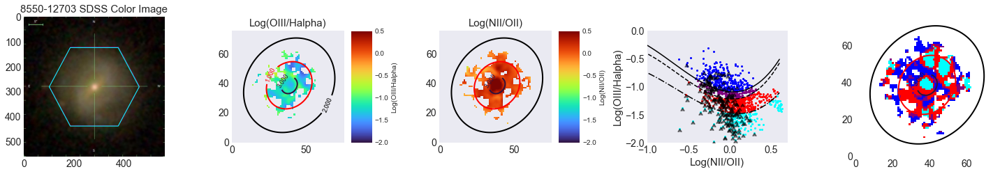

In [56]:
hdu = fits.open(bbrd_fits_list[3])
plateifu = hdu[0].header['PLATEIFU']
sample = 'bbrd'
n2o2_kcorr_ppd_map, o3ha_uplim_kcorr_ppd_map, o3ha_value_kcorr_ppd_map, o3ha_kcorr_tot_ppd_map, combo_const2dmap = Q18_2d_diagnostic(hdu, plateifu, sample)
hdu.close()

[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10




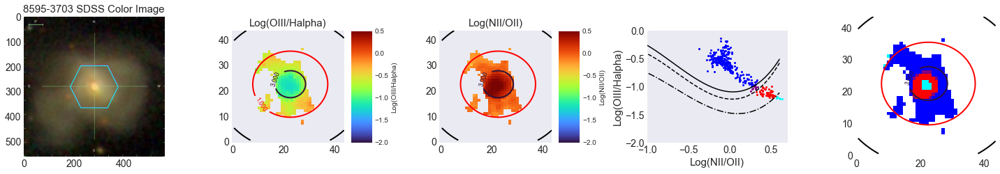

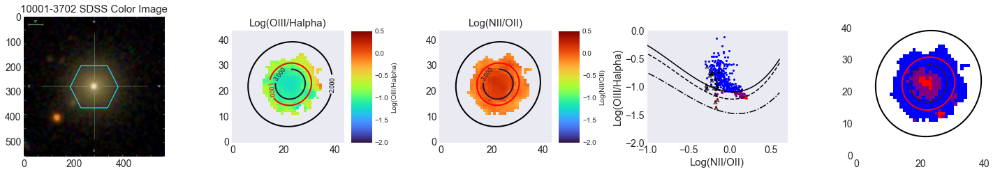

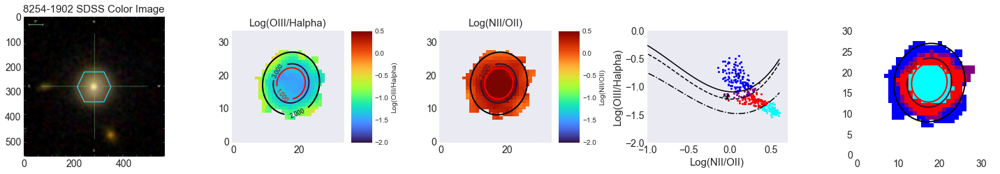

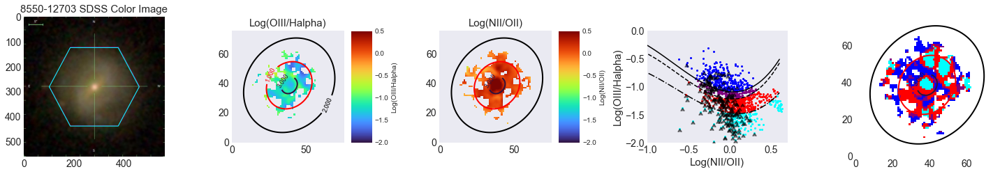

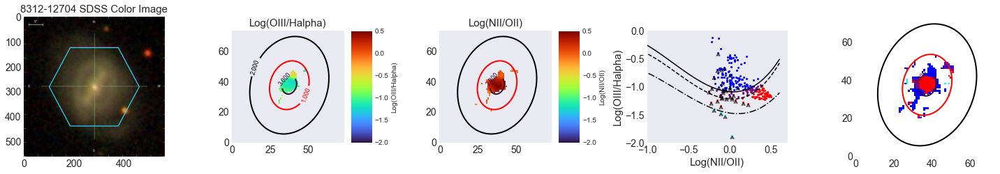

In [57]:
# Run function for all BBRD galaxies in results file
import glob
bbrd_fits_list = glob.glob('/Users/mmckay/Desktop/research/FMR_MZR/bbrd_result_fits/*_results.fits')

for fits_file in bbrd_fits_list:
    hdu = fits.open(fits_file)
    plateifu = hdu[0].header['PLATEIFU']
    sample = 'bbrd'
    n2o2_kcorr_ppd_map, o3ha_uplim_kcorr_ppd_map, o3ha_value_kcorr_ppd_map, o3ha_kcorr_tot_ppd_map, combo_const2dmap = Q18_2d_diagnostic(hdu, plateifu, sample)
    hdu.close()
    

[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning:

divide by zero encountered in log10


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


[WARNIN

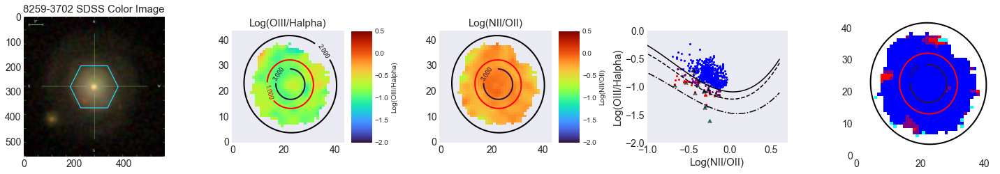

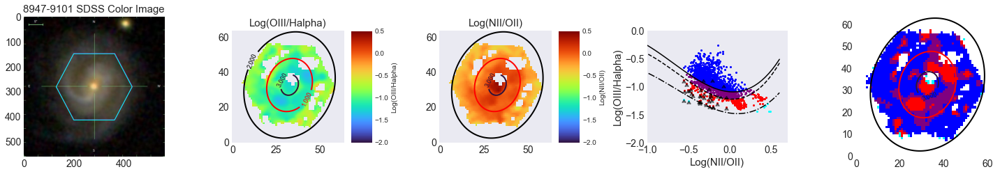

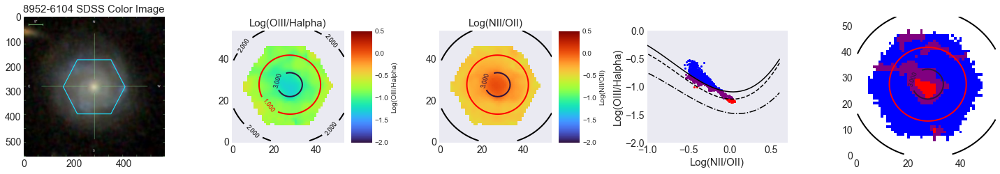

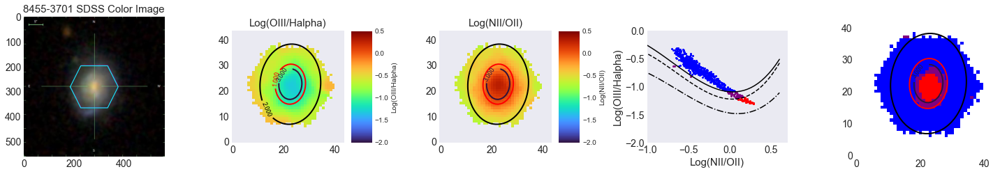

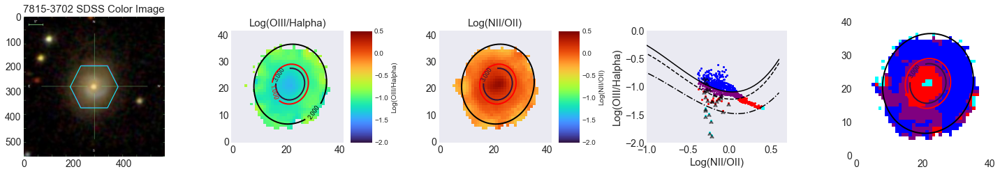

...

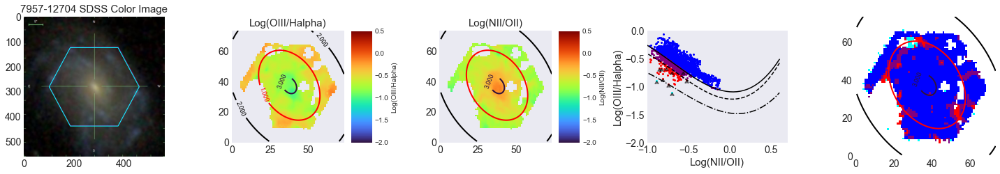

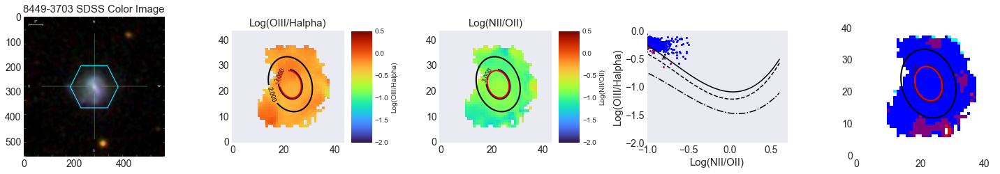

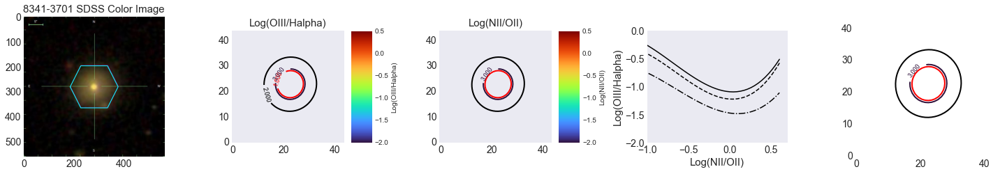

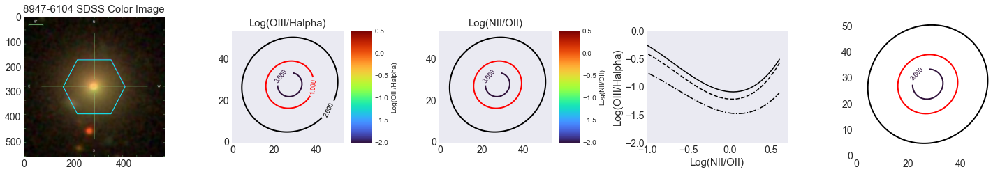

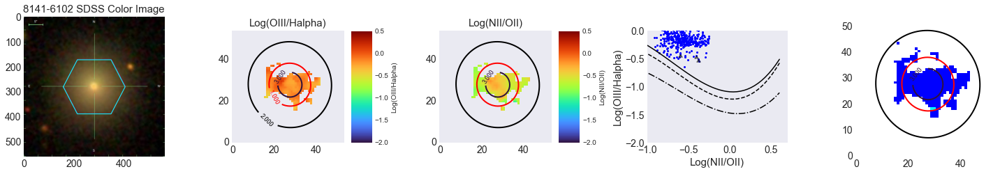

In [58]:
# Run function for all LG12 galaxies in results file
import glob
lg12_fits_list = glob.glob('/Users/mmckay/Desktop/research/FMR_MZR/lg12_result_fits/*_results.fits')
#lg12_plateifu_list = []
for fits_file in lg12_fits_list:
    #print(fits_file)
    hdu = fits.open(fits_file)
    plateifu = hdu[0].header['PLATEIFU']
    #lg12_plateifu_list.append(plateifu)
    sample = 'lg12'
    n2o2_kcorr_ppd_map, o3ha_uplim_kcorr_ppd_map, o3ha_value_kcorr_ppd_map, o3ha_kcorr_tot_ppd_map, combo_const2dmap = Q18_2d_diagnostic(hdu, plateifu, sample)
    hdu.close()

In [77]:
# jumbled download files from marvin code
# from marvin.utils.general import downloadList
# from marvin.tools.image import Image
# Image.download('8602-6103')
# #downloadList('8602-6103', dltype='image') # download images

# from tqdm.notebook import tqdm
# config.setRelease('DR16')
# # query manga functions
# def query_manga_map(plateifu_list, dr):
#     config.setRelease(dr)
#     downloadList(plateifu_list, dltype='maps') #download maps
#     downloadList(plateifu_list, dltype='image') # download images

In [52]:
#downloadList(lg12_plateifu_list, dltype='image') # download images

Progress: 100%|██████████| 59/59 [00:10<00:00,  5.89files/s, n_files=59, n_streams=5]SDSS_ACCESS> Done!



In [64]:
plateifu = '8550-12703'
sample = 'bbrd'
hdu = fits.open('/Users/mmckay/Desktop/research/FMR_MZR/{}_result_fits/{}_results.fits'.format(sample, plateifu))
hdu.info()

Filename: /Users/mmckay/Desktop/research/FMR_MZR/bbrd_result_fits/8550-12703_results.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  HALPHA        1 PrimaryHDU      12   (76, 76)   float32   
  1  HALPHA KCORR    2 ImageHDU         9   (76, 76)   float32   
  2  HBETA KCORR    3 ImageHDU         9   (76, 76)   float32   
  3  NII6585 KCORR    4 ImageHDU         9   (76, 76)   float32   
  4  OII3727 KCORR    5 ImageHDU         9   (76, 76)   float32   
  5  OII3729 KCORR    6 ImageHDU         9   (76, 76)   float32   
  6  OIII5008 KCORR    7 ImageHDU         9   (76, 76)   float32   
  7  SII6718 KCORR    8 ImageHDU         9   (76, 76)   float32   
  8  SII6732 KCORR    9 ImageHDU         9   (76, 76)   float32   
  9  HALPHA SNR   10 ImageHDU         9   (76, 76)   float32   
 10  HBETA SNR    11 ImageHDU         9   (76, 76)   float32   
 11  NII6585 SNR   12 ImageHDU         9   (76, 76)   float32   
 12  OII3727 SNR   13 ImageHDU         9   (76, 76)   flo

In [65]:
# fig = px.imshow(hdu['HALPHA KCORR'].data, zmin=1, zmax=10, origin='lower', color_continuous_scale='rdbu', labels={'color':'1e-17erg/s/spaxel/cm^2'})
# fig.add_trace(go.Contour(z=hdu['HALPHA'].data, showscale=False, line=dict(width=10, color='white'),
#                         contours=dict(start=0, end=10, size=0.5, coloring='lines', showlabels=True,
#                             labelfont = dict(size=10, color='white'
#                             )
#                         ),
#                         line_width=2, name='Halpha flux'))
# fig.update_layout(width=1000, height=1000)
# fig.show()

In [66]:
fig = px.imshow(hdu['HALPHA KCORR'].data, zmin=1, zmax=10, origin='lower', color_continuous_scale='rdbu', labels={'color':'1e-17erg/s/spaxel/cm^2'})
fig.add_trace(go.Contour(z=hdu['HALPHA'].data, showscale=False, line=dict(width=10, color='white'),
                        contours=dict(start=0, end=10, size=0.5, coloring='lines', showlabels=True,
                            labelfont = dict(size=10, color='white'
                            )
                        ),
                        line_width=2, name='Halpha flux'))
fig.update_layout(width=1000, height=1000)
fig.show()

In [67]:
# Applying Preprocessing to emission flux maps
ha_kcorr_ppd_map = apply_2Difu_snr_cut(hdu['HALPHA KCORR'].data)
o3_kcorr_ppd_map = apply_2Difu_snr_cut(hdu['OIII5008 KCORR'].data)
n2_kcorr_ppd_map = apply_2Difu_snr_cut(hdu['NII6585 KCORR'].data)
o2_3727_kcorr_ppd_map = apply_2Difu_snr_cut(hdu['OII3727 KCORR'].data)
o2_3729_kcorr_ppd_map = apply_2Difu_snr_cut(hdu['OII3729 KCORR'].data)


# Applying Preprocessing (ppd) to emission flux S/N maps
ha_SNR_ppd_map = apply_2Difu_snr_cut(hdu['HALPHA SNR'].data)
o3_SNR_ppd_map = apply_2Difu_snr_cut(hdu['OIII5008 SNR'].data)
n2_SNR_ppd_map = apply_2Difu_snr_cut(hdu['NII6585 SNR'].data)
o2_3727_SNR_ppd_map = apply_2Difu_snr_cut(hdu['OII3727 SNR'].data)
o2_3729_SNR_ppd_map = apply_2Difu_snr_cut(hdu['OII3729 SNR'].data)

### Split OIII Map values into OIII/Halpha upper limit spaxels(OIII S/N < 2) and other 
o3low_kcorr_ppd_map = np.copy(o3_kcorr_ppd_map)
o3val_kcorr_ppd_map = np.copy(o3_kcorr_ppd_map)


# (OIII/Halpha upper limit)
o3low_kcorr_ppd_map[o3_SNR_ppd_map > 2] = np.nan # Set spaxels with S/N > 2 to nan
o3val_kcorr_ppd_map[o3_SNR_ppd_map < 2] = np.nan # Set spaxels with S/N < 2 to nan



# Calculate the Q18 diagnostic ratios
o3ha_kcorr_tot_ppd_map = np.log10(o3_kcorr_ppd_map / ha_kcorr_ppd_map) # All spaxels 
o3ha_uplim_kcorr_ppd_map = np.log10(o3low_kcorr_ppd_map / ha_kcorr_ppd_map) # Only OIII/Halpha upper limit
o3ha_value_kcorr_ppd_map = np.log10(o3val_kcorr_ppd_map / ha_kcorr_ppd_map) # All spaxels below OIII/Halpha upper limit
n2o2_kcorr_ppd_map = np.log10(n2_kcorr_ppd_map / (o2_3727_kcorr_ppd_map + o2_3729_kcorr_ppd_map))


# remove inf and -inf values
#N2O2
n2o2_kcorr_ppd_map[n2o2_kcorr_ppd_map == np.inf] = np.nan
n2o2_kcorr_ppd_map[n2o2_kcorr_ppd_map == -np.inf] = np.nan

#O3Ha upper limits
o3ha_uplim_kcorr_ppd_map[o3ha_uplim_kcorr_ppd_map == np.inf] = np.nan
o3ha_uplim_kcorr_ppd_map[o3ha_uplim_kcorr_ppd_map == -np.inf] = np.nan

#O3Ha normal values
o3ha_value_kcorr_ppd_map[o3ha_value_kcorr_ppd_map == np.inf] = np.nan
o3ha_value_kcorr_ppd_map[o3ha_value_kcorr_ppd_map == -np.inf] = np.nan

#O3Ha full map(both upperlimit and normal values)
o3ha_kcorr_tot_ppd_map[o3ha_kcorr_tot_ppd_map == np.inf] = np.nan
o3ha_kcorr_tot_ppd_map[o3ha_kcorr_tot_ppd_map == -np.inf] = np.nan


# Set values to constants depending on the location on the q18 fit -- for 2d maps
above_q18med_constmap =  np.copy(above_q18med)
above_q18med_constmap[above_q18med > -777] = 1 # spaxels avove median

q18std1_q18med_constmap =  np.copy(q18std1_q18med)
q18std1_q18med_constmap[q18std1_q18med > -777] = 2 # spaxels between median and 1stddev

q18std1_q18std3_constmap =  np.copy(q18std1_q18std3)
q18std1_q18std3_constmap[q18std1_q18std3 > -777] = 3 # spaxels between 1stddev and 3stddev

below_q18std3_constmap =  np.copy(below_q18std3) # spaxel below 3stddev
below_q18std3_constmap[below_q18std3 > -777] = 4

#null_undefined_value_constmap = 

# Combine the constant maps
combo_const3dmap = np.dstack((above_q18med_constmap, q18std1_q18med_constmap, q18std1_q18std3_constmap, below_q18std3_constmap))

combo_const2dmap = np.nansum(combo_const3dmap, axis=2)
combo_const2dmap.shape

[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:28: RuntimeWarning:

divide by zero encountered in log10




(76, 76)

In [68]:
# Extract Map values into 4 sections depending on the position from Q18 median polynomial fit
# 1. make a function to calculate median fit
# 2. Use the function to calculate Q18 polyfit using the n2o2 relation 
# 3. split the values into 4 individule maps by masking the maps
# 4. Plot all the maps in combination

# Q18 fit fundtion
def q18_diagnostic_polyfit(Q18_n2o2_range = np.linspace(-1.5,0.6,50)):
    Q18_o3ha_range_medfit = -1.09 - (0.11 * Q18_n2o2_range) + (1.39 * Q18_n2o2_range**2) + (0.67 * Q18_n2o2_range**3)
    Q18_o3ha_range_1sigma = -1.22 - (0.09 * Q18_n2o2_range) + (1.48 * Q18_n2o2_range**2) + (0.76 * Q18_n2o2_range**3) # 16th percentile of fit but rerpersents 1 sigma
    Q18_o3ha_range_3sigma = -1.47 - (0.21 * Q18_n2o2_range) + (1.04 * Q18_n2o2_range**2) + (0.53 * Q18_n2o2_range**3) # .15th percentile of fit but rerpersents 3 sigma
    
    return Q18_o3ha_range_medfit, Q18_o3ha_range_1sigma, Q18_o3ha_range_3sigma

# Q18 median, 1stddev, 3stddev
# Q18_o3ha_range_medfit, Q18_o3ha_range_1sigma, Q18_o3ha_range_3sigma = q18_diagnostic_polyfit()

# spaxels above the Q18 median fit by setting all other values to nan values 
above_q18med = np.copy(o3ha_kcorr_tot_ppd_map)
above_q18med[o3ha_kcorr_tot_ppd_map <= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[0]] = np.nan 

# spaxels between median fit and 1 stddev fit
q18std1_q18med = np.copy(o3ha_kcorr_tot_ppd_map)
q18std1_q18med[o3ha_kcorr_tot_ppd_map <= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[1]] = np.nan
q18std1_q18med[o3ha_kcorr_tot_ppd_map >= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[0]] = np.nan

# spaxels between 1 stddev fit and 3 stddev fit
q18std1_q18std3 = np.copy(o3ha_kcorr_tot_ppd_map)
q18std1_q18std3[o3ha_kcorr_tot_ppd_map <= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[2]] = np.nan
q18std1_q18std3[o3ha_kcorr_tot_ppd_map >= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[1]] = np.nan

# spaxels below the 3 stddev fit 
below_q18std3 = np.copy(o3ha_kcorr_tot_ppd_map)
below_q18std3[o3ha_kcorr_tot_ppd_map >= q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[2]] = np.nan



In [69]:
# Set values to constants depending on the location on the q18 fit -- for 2d maps
above_q18med_constmap =  np.copy(above_q18med)
above_q18med_constmap[above_q18med > -777] = 1 # spaxels avove median

q18std1_q18med_constmap =  np.copy(q18std1_q18med)
q18std1_q18med_constmap[q18std1_q18med > -777] = 2 # spaxels between median and 1stddev

q18std1_q18std3_constmap =  np.copy(q18std1_q18std3)
q18std1_q18std3_constmap[q18std1_q18std3 > -777] = 3 # spaxels between 1stddev and 3stddev

below_q18std3_constmap =  np.copy(below_q18std3) # spaxel below 3stddev
below_q18std3_constmap[below_q18std3 > -777] = 4

#null_undefined_value_constmap = 

# Combine the constant maps
combo_const3dmap = np.dstack((above_q18med_constmap, q18std1_q18med_constmap, q18std1_q18std3_constmap, below_q18std3_constmap))

combo_const2dmap = np.nansum(combo_const3dmap, axis=2)
combo_const2dmap.shape

(76, 76)

In [70]:
fig = px.imshow(combo_const2dmap, zmin=0, zmax=4, origin='lower', color_continuous_scale='blackbody', labels={'color':'Q18_class'})
# Elliptical Radius contour
fig.add_trace(go.Contour(z=hdu['ELLIP R'].data, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=3, end=3, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='white'
                           )
                       ),
                       line_width=2, name='Ellip Radius'))

# Elliptical Radius / Effective Radius (R/Reff) contour
fig.add_trace(go.Contour(z=hdu['R/REFF'].data, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=1, end=2, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='white'
                           )
                       ),
                       line_width=5, name='R/Reff'))

fig.update_layout(width=1000, height=1000)
fig.show()

[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:9: MatplotlibDeprecationWarning:

The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.




Text(0.5, 1.0, '')

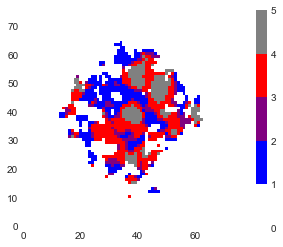

In [71]:
from matplotlib import colors
cmap = colors.ListedColormap(['white','blue', 'purple','red','grey'])
bounds=[0,1,2,3,4,5]
norm = colors.BoundaryNorm(bounds, cmap.N)
# tell imshow about color map so that only set colors are used
im = plt.imshow(combo_const2dmap, interpolation='nearest', origin='lower',
                    cmap=cmap, norm=norm)
# make a color bar
plt.colorbar(im, cmap=cmap, boundaries=bounds, ticks=bounds)
#ax7.set_aspect(1)
plt.title('', fontsize=14)

In [72]:
# plt.figure(figsize=(20, 20))
# plt.imshow(above_q18med_constmap,cmap='flag', origin='lower', vmin=1)
# plt.imshow(q18std1_q18med, cmap='flag', origin='lower')
# plt.imshow(q18std1_q18std3, cmap='flag',origin='lower')
# plt.imshow(below_q18std3, cmap='flag',  origin='lower')

(-2.0, 0.0)

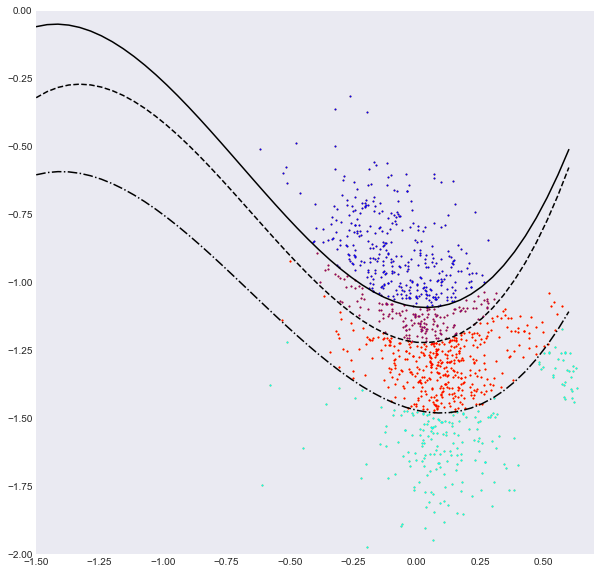

In [73]:
# Quai et al 2018 O3Halpha vs N2O2 polynomial
Q18_n2o2_range = np.linspace(-1.5,0.6,50)
Q18_o3ha_range = np.linspace(-1.75,0.25,50)

q18_polyfit = -1.09 - (0.11 * Q18_n2o2_range) + (1.39 * Q18_n2o2_range**2) + (0.67 * Q18_n2o2_range**3)
q18_polyfit_1sigma = -1.22 - (0.09 * Q18_n2o2_range) + (1.48 * Q18_n2o2_range**2) + (0.76 * Q18_n2o2_range**3) # 16th percentile of fit but rerpersents 1 sigma
q18_polyfit_3sigma = -1.47 - (0.21 * Q18_n2o2_range) + (1.04 * Q18_n2o2_range**2) + (0.53 * Q18_n2o2_range**3) # .15th percentile of fit but rerpersents 3 sigma



# test Q18 diagnostic plot
plt.figure(figsize=(10,10))
#plt.plot(n2o2_kcorr_ppd_map, q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[0], color='pink', linewidth=1)
#plt.plot(n2o2_kcorr_ppd_map, q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[1], color='pink', linewidth=1)
#plt.plot(n2o2_kcorr_ppd_map, q18_diagnostic_polyfit(n2o2_kcorr_ppd_map)[2], color='pink', linewidth=1)
plt.plot(Q18_n2o2_range, q18_polyfit, color='black')
plt.plot(Q18_n2o2_range, q18_polyfit_1sigma, color='black', linestyle='--')
plt.plot(Q18_n2o2_range, q18_polyfit_3sigma, color='black', linestyle='-.')

plt.scatter(n2o2_kcorr_ppd_map, o3ha_value_kcorr_ppd_map, s=1, color='orange')
plt.scatter(n2o2_kcorr_ppd_map, o3ha_uplim_kcorr_ppd_map, s=1, color='orange')
plt.scatter(n2o2_kcorr_ppd_map, above_q18med, s=1, color='blue')
plt.scatter(n2o2_kcorr_ppd_map, q18std1_q18med, s=1, color='purple')
plt.scatter(n2o2_kcorr_ppd_map, q18std1_q18std3, s=1, color='red')
plt.scatter(n2o2_kcorr_ppd_map, below_q18std3, s=1, color='cyan')



plt.xlim(-1.5,0.7)
plt.ylim(-2,0.0)

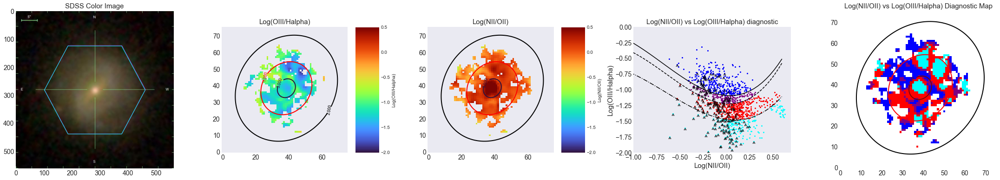

In [74]:
# Q18 diagnostic plot
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=(30,13))
# SDSS color Image
im1 = Image(plateifu)
imfn = im1.filename
img = mpimg.imread(imfn)
imgplot = ax1.imshow(img, aspect=1)
im1.overlay_hexagon(ax1, color='cyan', linewidth=1)
ax1.set_title('SDSS Color Image', fontsize=15)
ax1.tick_params(labelsize=14)
ax1.set_aspect(1)

# Log(OIII/Halpha)
im2 = ax2.imshow(o3ha_value_kcorr_ppd_map, vmin=-2, vmax=0.5, origin='lower', cmap='turbo')
fig.colorbar(im2, ax=ax2, label='Log(OIII/Halpha)', aspect=5.3, orientation='vertical')
# R/Reff contour
CS = ax2.contour(hdu['R/Reff'].data, levels = np.arange(1, 3, 1), origin='lower', cmap='flag', linewidths=2)
ax2.clabel(CS, fontsize=9, inline=1)
# Ellip Contour
CS = ax2.contour(hdu['ELLIP R'].data, levels=np.arange(3, 4, 1), origin='lower', cmap='turbo', linewidths=2)
ax2.clabel(CS, fontsize=9, inline=1)
ax2.set_title('Log(OIII/Halpha)', fontsize=15)
ax2.tick_params(labelsize=14)
ax2.set_aspect(1)

# Log(NII/OII)
im3 = ax3.imshow(n2o2_kcorr_ppd_map, vmin=-2, vmax=0.5, origin='lower', cmap='turbo')
fig.colorbar(im3, ax=ax3, label='Log(NII/OII)', aspect=5.3, orientation='vertical')
# R/Reff contour
levels = np.arange(1, 3, 1)
CS = ax3.contour(hdu['R/Reff'].data, levels, origin='lower', cmap='flag', linewidths=2)
# Ellip Contour
CS = ax3.contour(hdu['ELLIP R'].data, levels=np.arange(3, 4, 1), origin='lower', cmap='turbo', linewidths=2)
ax3.clabel(CS, fontsize=9, inline=1)
ax3.set_title('Log(NII/OII)', fontsize=15)
ax3.tick_params(labelsize=14)
ax3.set_aspect(1)

# Log(NII/OII) vs Log(OIII/Halpha) diagnostic
#im4 = ax4.scatter(n2o2_kcorr_ppd_map, o3ha_kcorr_tot_ppd_map, s=1, c=hdu['ELLIP R'].data, cmap='turbo', vmin=2, vmax=15)
# plt.plot(Q18_n2o2_range, q18_polyfit, color='black')
# plt.plot(Q18_n2o2_range, q18_polyfit_1sigma, color='black', linestyle='--')
# plt.plot(Q18_n2o2_range, q18_polyfit_3sigma, color='black', linestyle='-.')
ax4.scatter(n2o2_kcorr_ppd_map, above_q18med, s=4, color='blue')
ax4.scatter(n2o2_kcorr_ppd_map, q18std1_q18med, s=4, color='purple')
ax4.scatter(n2o2_kcorr_ppd_map, q18std1_q18std3, s=4, color='red')
ax4.scatter(n2o2_kcorr_ppd_map, below_q18std3, s=4, color='cyan')
#im4 = ax4.scatter(n2o2_kcorr_ppd_map, o3ha_value_kcorr_ppd_map, s=3, c=hdu['ELLIP R'].data, cmap='turbo', vmin=0, vmax=15)
im5 = ax4.scatter(n2o2_kcorr_ppd_map, o3ha_uplim_kcorr_ppd_map, s=30, color='black', marker=6, alpha=0.5, edgecolors='face')
#fig.colorbar(im4, ax=ax4, label='Ellipitical Radius[arcsec]', aspect=5.3, orientation='vertical')
ax4.plot(Q18_n2o2_range, q18_polyfit, color='black')
ax4.plot(Q18_n2o2_range, q18_polyfit_1sigma, color='black', linestyle='--')
ax4.plot(Q18_n2o2_range, q18_polyfit_3sigma, color='black', linestyle='-.')
ax4.set_title('Log(NII/OII) vs Log(OIII/Halpha) diagnostic', fontsize=15)
ax4.set_xlabel('Log(NII/OII)', fontsize=15)
ax4.set_ylabel('Log(OIII/Halpha)', fontsize=15)
ax4.set_xlim(-1.0,0.7)
ax4.set_ylim(-2.0,0)
ax4.tick_params(labelsize=14)
ax4.set_aspect(.68)

# Color-coded diagnostic
cmap = colors.ListedColormap(['white','blue', 'purple','red','cyan'])
bounds=[0,1,2,3,4,5]
norm = colors.BoundaryNorm(bounds, cmap.N) # tell imshow about color map so that only set colors are used
im6 = plt.imshow(combo_const2dmap, interpolation='nearest', origin='lower',cmap=cmap, norm=norm)
#fig.colorbar(im6, cmap=cmap, boundaries=bounds, ticks=bounds, ax=ax5, aspect=5.3) # make a color bar
plt.title('Log(NII/OII) vs Log(OIII/Halpha) Diagnostic Map', fontsize=15)
# R/Reff contour
levels = np.arange(1, 3, 1)
CS = ax5.contour(hdu['R/Reff'].data, levels, origin='lower', cmap='flag', linewidths=2)
# Ellip Contour
CS = ax5.contour(hdu['ELLIP R'].data, levels=np.arange(3, 4, 1), origin='lower', cmap='turbo_r', linewidths=2)
ax5.clabel(CS, fontsize=9, inline=1)
ax5.tick_params(labelsize=14)
ax5.set_aspect(1)
fig.tight_layout()


#plt.show()

## Make interactive plots with plotly

In [75]:
fig = px.imshow(o3ha_kcorr_ppd_map, zmin=-2, zmax=0, origin='lower', color_continuous_scale='blackbody', labels={'color':'Log(O3/Halpha)'})
#fig.add_trace(go.Contour(z=n2o2_kcorr_ppd_map, showscale=False, line=dict(width=10, color='white'),
#                       contours=dict(start=-1, end=1, size=0.3, coloring='lines', showlabels=True,
#                           labelfont = dict(size=10, color='white'
#                           )
#                       ),
#                       line_width=2, name='Log(NII/OII)'))
# OIII SNR contour
fig.add_trace(go.Contour(z=o3_SNR_ppd_map, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=0, end=3, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='white'
                           )
                       ),
                       line_width=2, name='OIII S/N > 3 upper limit'))

# Elliptical Radius contour
fig.add_trace(go.Contour(z=hdu['ELLIP R'].data, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=3, end=3, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='black'
                           )
                       ),
                       line_width=2, name='Ellip Radius'))

# Elliptical Radius / Effective Radius (R/Reff) contour
fig.add_trace(go.Contour(z=hdu['R/REFF'].data, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=1, end=2, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='black'
                           )
                       ),
                       line_width=2, name='R/Reff'))

fig.update_layout(width=1000, height=1000)
fig.show()
fig.write_html('/Users/mmckay/Desktop/research/FMR_MZR/Quai2018_diagnostic_html/o3ha_ratio.html')

NameError: name 'o3ha_kcorr_ppd_map' is not defined

In [25]:
fig = px.imshow(n2o2_kcorr_ppd_map, zmin=-1, zmax=0.5, origin='lower', color_continuous_scale='blackbody', labels={'color':'Log(NII/OII)'})
#fig.add_trace(go.Contour(z=n2o2_kcorr_ppd_map, showscale=False, line=dict(width=10, color='white'),
#                       contours=dict(start=-1, end=1, size=0.3, coloring='lines', showlabels=True,
#                           labelfont = dict(size=10, color='white'
#                           )
#                       ),
#                       line_width=2, name='Log(NII/OII)'))
# OIII SNR contour
fig.add_trace(go.Contour(z=o3_SNR_ppd_map, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=0, end=3, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='white'
                           )
                       ),
                       line_width=2, name='OIII S/N > 3 upper limit'))

# Elliptical Radius contour
fig.add_trace(go.Contour(z=hdu['ELLIP R'].data, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=3, end=3, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='black'
                           )
                       ),
                       line_width=2, name='Ellip Radius'))

# Elliptical Radius / Effective Radius (R/Reff) contour
fig.add_trace(go.Contour(z=hdu['R/REFF'].data, showscale=False, line=dict(width=10, color='white'),
                       contours=dict(start=1, end=2, size=1, coloring='lines', showlabels=True,
                           labelfont = dict(size=10, color='black'
                           )
                       ),
                       line_width=2, name='R/Reff'))

fig.update_layout(width=1000, height=1000)
fig.show()
fig.write_html('/Users/mmckay/Desktop/research/FMR_MZR/Quai2018_diagnostic_html/n2o2_ratio.html')

## Extra -----------------------------

In [68]:
# Attempting to make subplot in plotly - skill development work on later
from plotly.subplots import make_subplots
fig = make_subplots(rows=1, cols=4, shared_yaxes=True, shared_xaxes=True)
fig.add_trace(px.imshow(hdu['HALPHA'].data).data[0], 1, 1)
fig.add_trace(go.Contour(z=hdu['HALPHA'].data, showscale=False,
                        contours=dict(start=0, end=6, size=0.5, coloring='lines', 
                            labelfont = dict(size=3, color='white') 
                        ),
                        line_width=2, name='Halpha flux'), row=1, col=1, )

fig.add_trace(px.imshow(hdu['HALPHA KCORR'].data).data[0], 1, 2)
fig.add_trace(px.imshow(hdu['HBETA KCORR'].data).data[0], 1, 3)
fig.add_trace(px.imshow(hdu['OIII5008 KCORR'].data).data[0], 1, 4)
#fig.add_box(name='Halpha', row=1, col=3)
fig.update_layout(width=1500, height=450)
fig.show()

plotly.graph_objs._figure.Figure